load packages

In [1]:
using GeoPhyInv
using Statistics
using Plots
pyplot()

Plots.PyPlotBackend()

create simple (almost) homogeneous acoustic model

In [2]:
model=J.Gallery.Seismic(:acou_homo1)
J.Models.Seismic_addon!(model, randn_perc=0.01)

GeoPhyInv.Models.Seismic([1500.0, 3500.0], [1.0, 1.0], [1500.0, 3500.0], [-0.000124928 7.0287e-5 … 1.3282e-5 -0.00014051; 0.000101282 8.09302e-5 … -0.000279224 -8.61817e-5; … ; -1.3379e-7 5.23233e-5 … -6.08232e-5 -7.20386e-5; -0.000124766 -2.53334e-5 … 0.000158775 -3.65609e-5], [-1.95287e-5 -1.2635e-5 … 6.08019e-5 -2.25287e-6; -0.000108944 0.000272777 … -0.000166974 -6.45661e-5; … ; 0.000108025 -8.96709e-5 … -1.23195e-5 3.01955e-5; -0.000159939 -0.000127539 … 3.72163e-5 3.07386e-5], [-7.81298e-5 0.000109786 … 3.34199e-5 1.44259e-5; -0.000113012 -4.29621e-5 … 9.79359e-5 -8.32209e-6; … ; -0.000224516 7.03851e-5 … 1.28244e-5 -0.000108623; -9.15358e-5 3.27738e-5 … 0.000134962 -6.10021e-6], StepRangeLen{Float64,Base.TwicePrecision{Float64},Base.TwicePrecision{Float64}}[-1000.0:10.0:1000.0, -1000.0:10.0:1000.0], [3.375e9, 4.2875e10], [1500.0, 3500.0], [2.33236e-11, 2.96296e-10], [0.000285714, 0.000666667], [0.000285714, 0.000666667], GeoPhyInv.Models.Seismic_ref{Float64}(2500.0, 1.0, 2500.0,

a simple acquisition geometry

In [3]:
acqgeom = GeoPhyInv.Gallery.Geom(model.mgrid,:xwell);

	Acquisition Geometry:	xwell
	> number of supersources:	2
	> sources per supersource:	min	1	max	1
	> receivers per supersource:	min	2	max	2
	> number of unique positions of:	sources	2	receivers	2


plot the model and source, receivers

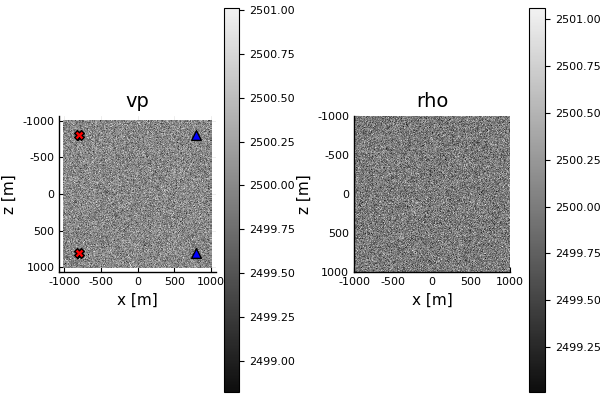

In [4]:
p1=JP.seismic(model)
JP.geom!(acqgeom)
plot(p1)

generate time grid

In [5]:
tgrid = range(0.0,stop=2.0,length=1000)

0.0:0.002002002002002002:2.0

Ricker wavelet

In [6]:
wav = GeoPhyInv.Utils.Wavelets.ricker(10.0, tgrid, tpeak=0.25,);

distribute the same source wavelet to all the supsersources

In [7]:
acqsrc=GeoPhyInv.Acquisition.Src_fixed(acqgeom.nss,1,[:P],wav,tgrid);

create `Fdtd.Param` object to prepare forward modelling
* npw corresponds to the number of independently propagating wavefields (1 in most cases)

In [8]:
pa=GeoPhyInv.Fdtd.Param(npw=1,model=model,
	acqgeom=[acqgeom], acqsrc=[acqsrc],
	sflags=[2], rflags=[1],
	tgridmod=tgrid, verbose=true);

┌ Info: spatial sampling (1.00e+01) can be as high as 1.02e+01
└ @ GeoPhyInv.Fdtd /math/home/pawbz/.julia/dev/GeoPhyInv/src/Fdtd/Fdtd.jl:1001
┌ Warning: decrease time sampling (2.00e-03) below 1.43e-03
└ @ GeoPhyInv.Fdtd /math/home/pawbz/.julia/dev/GeoPhyInv/src/Fdtd/Fdtd.jl:1012


Once the `Param` object is created, do the modelling "without any memory allocations" using `mod!`

In [9]:
@time GeoPhyInv.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.96s / 94.8%           23.5MiB / 17.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.70s   100%   4.70s   4.00MiB  98.9%  4.00MiB
 initialize!            1   2.65ms  0.06%  2.65ms   37.0KiB  0.89%  37.0KiB
 record data            1   88.3μs  0.00%  88.3μs   8.56KiB  0.21%  8.56KiB
 stack_grads!           1   50.1μs  0.00%  50.1μs   2.05KiB  0.05%  2.05KiB
 update gradient        1    108ns  0.00%   108ns         -  0.00%        -
 ──────────────────

plot a record after modelling

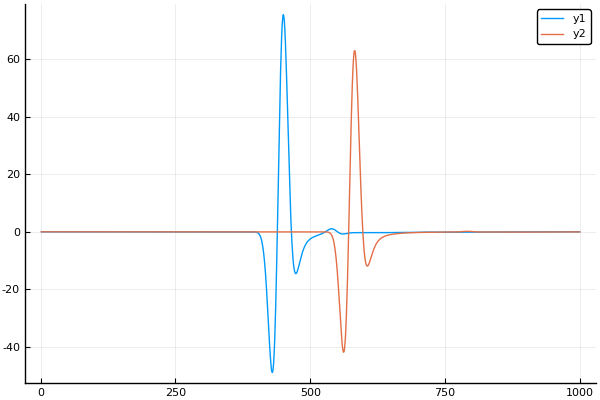

In [10]:
pdata=plot(pa.c.data[1].d[1,1])
plot(pdata)

create new seismic model

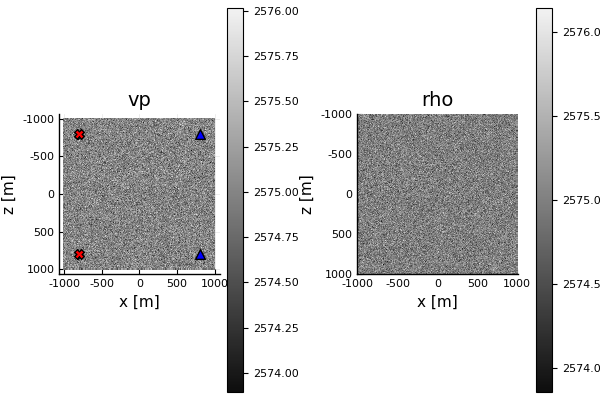

In [11]:
model_new=J.Gallery.Seismic(:acou_homo1) # prepare another model
J.Models.Seismic_addon!(model_new, randn_perc=0.01)
J.Models.Seismic_addon!(model_new, constant_pert=0.03) # perturb the model
p2=JP.seismic(model_new) # plot new model
JP.geom!(acqgeom)
plot(p2)

Now, we the change the model in the `Param` object without memory allocation
This routine can be used during FWI,
where medium parameters are itertively updated in the same `Fdtd.Param` object

In [12]:
J.Fdtd.update_model!(pa.c, model_new)

run modelling now and plot data again

In [13]:
@time GeoPhyInv.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.79s / 100%             278KiB / 98.5%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.78s   100%   4.78s    225KiB  82.5%   225KiB
 initialize!            1   9.12ms  0.19%  9.12ms   37.2KiB  13.6%  37.2KiB
 record data            1   99.1μs  0.00%  99.1μs   8.25KiB  3.02%  8.25KiB
 stack_grads!           1   55.8μs  0.00%  55.8μs   2.39KiB  0.87%  2.39KiB
 update gradient        1    110ns  0.00%   110ns         -  0.00%        -
 ──────────────────

plot a record after modelling

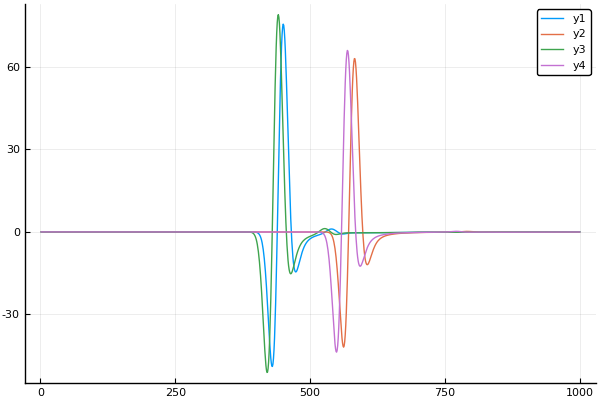

In [14]:
plot!(pdata, pa.c.data[1].d[1,1])
plot(pdata)

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*